# An implementation of Quantum-Selected Configuration Interaction (QSCI)
See the paper: https://arxiv.org/abs/2302.11320 for QSCI method.\
The final goal of this notebook is to reproduce Fig. 3 in the paper for the ground state calculation of the water molecule.\
Note that the extention  of this implementation to the excited states calculation is future work. 

# Setting for H$_{2}$O molecule and HF calculation

In [1]:
import os
os.environ["OPENBLAS_NUM_THREADS"] = "8"
os.environ["MKL_NUM_THREADS"] = "8"
os.environ["VECLIB_NUM_THREADS"] = "8"
os.environ["QULACS_NUM_THREADS"] = "8"

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from openfermion.chem import MolecularData
from openfermion.transforms import get_fermion_operator, jordan_wigner, bravyi_kitaev
from openfermion.linalg import get_sparse_operator
from openfermion.ops import FermionOperator
from openfermionpyscf import run_pyscf
from pyscf import fci, mcscf

# ------------------------------------------------------
# positional data obtained from the paper
# xyz coordinates for atoms (angstrom)
#geometry = [("O", (0.0, 0.0,  0.0)),
#            ("H", (0.2774,  0.8929,  0.2544)),
#            ("H", (0.6068, -0.2383, -0.7169))]  #E = -74.96444758277

geometry = [("O", (0.0,      0.0,    0.0)),
            ("H", (-0.7635, -0.5967, 0.0)),
            ("H", ( 0.7635, -0.5967, 0.0))]  # rotating original coordinate because error in create_observable_from_openfermion_text
basis = "sto-3g"  #basis set
charge = 0        #total charge for the molecule
multiplicity = 1  #spin multiplicity 2S +1: 1 for singlet, 3 for triplet
# ------------------------------------------------------

molecule = MolecularData(geometry, basis, multiplicity, charge)
molecule = run_pyscf(molecule, run_scf=True, run_fci=False, run_ccsd=False, verbose=False)
print("HF energy: {} (Hartree)".format(molecule.hf_energy))
print("FCI energy: {} (Hartree)".format(molecule.fci_energy))

nele = molecule.n_electrons
norb = molecule.n_orbitals              # number of spatial orbitals
nspinorb = nqubits = molecule.n_qubits  # number of spin orbitals
print(f"nele = {nele}, norb = {norb}, nspinorb = nqubits = {nqubits}")

HF energy: -74.96444876753932 (Hartree)
FCI energy: None (Hartree)
nele = 10, norb = 7, nspinorb = nqubits = 14


# Visualization of MOs
See the following URLs:  
https://www.andersle.no/posts/2022/mo/mo.html  
https://future-chem.com/py3dmol/  

In [2]:
# For visualization of molecules and orbitals:
import py3Dmol

# For plotting
import seaborn as sns
sns.set_theme(style="ticks", context="talk", palette="muted")

# For numerics:
import pandas as pd
pd.options.display.float_format = "{:,.3f}".format

In [3]:
# molecule._pyscf_data["scf"].analyze(verbose=5)
# print(molecule._pyscf_data["scf"].__dict__)
mol   = molecule._pyscf_data["mol"]
mf    = molecule._pyscf_data["scf"]
mo_occ_table = pd.DataFrame({"Energy": mf.mo_energy, "Occupancy": mf.mo_occ})
print(mo_occ_table)

   Energy  Occupancy
0 -20.244      2.000
1  -1.263      2.000
2  -0.611      2.000
3  -0.453      2.000
4  -0.391      2.000
5   0.595      0.000
6   0.727      0.000


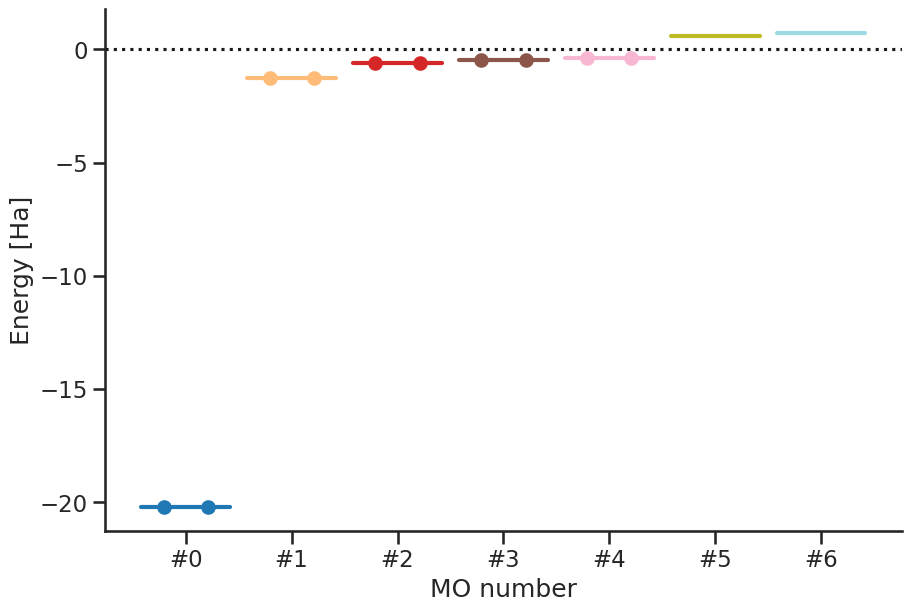

In [4]:
%matplotlib inline
fig, ax = plt.subplots(constrained_layout=True, figsize=(9, 6))
colors = matplotlib.cm.tab20(np.linspace(0, 1, len(mf.mo_energy)))  # get_cmap() will be removed in Matplotlib 3.7

pos = []
for i, (energy, occ) in enumerate(zip(mf.mo_energy, mf.mo_occ)):
    left = 3 * i
    right = 3 * i + 2.5
    length = right - left

    (line,) = ax.plot([left, right], [energy, energy], color=colors[i], lw=3)

    electron_x, electron_y = None, None
    if occ == 2:
        electron_x = [left + 0.25 * length, left + 0.75 * length]
        electron_y = [energy, energy]
    elif occ == 1:
        electron_x, electron_y = [left + 0.5], [energy]
    if electron_x and electron_y:
        ax.scatter(electron_x, electron_y, color=line.get_color())

    pos.append(left + 0.5 * length)

ax.axhline(y=0, ls=":", color="k")
ax.set_xticks(pos)
ax.set_xticklabels([f"#{i}" for i, _ in enumerate(pos)])
ax.set(xlabel="MO number", ylabel="Energy [Ha]")
sns.despine(fig=fig)

In [5]:
import pathlib
from pyscf import tools
def write_all_coeffs(
    mol, coeffs, prefix="cmo", dirname=".", margin=5, offset=0
):
    """Write cube files for the given coefficients."""
    path = pathlib.Path(dirname)
    path.mkdir(parents=True, exist_ok=True)

    for i in range(coeffs.shape[1]):
        outfile = f"{prefix}_{i+offset:02d}.cube"
        outfile = path / outfile
        print(f"Writing {outfile}")
        tools.cubegen.orbital(mol, outfile, coeffs[:, i], margin=margin)

write_all_coeffs(mol, mf.mo_coeff, prefix=f"cmo", dirname="cmo", margin=5)

Writing cmo/cmo_00.cube
Writing cmo/cmo_01.cube
Writing cmo/cmo_02.cube
Writing cmo/cmo_03.cube
Writing cmo/cmo_04.cube
Writing cmo/cmo_05.cube
Writing cmo/cmo_06.cube


In [6]:
import py3Dmol
from pyscf import gto
mol_xyz = gto.mole.tostring(mol, format="xyz")
print(mol_xyz)

with open("cmo/cmo_02.cube", "r") as f:
    cube = f.read()

view = py3Dmol.view(width=300, height=300)
view.setBackgroundColor('#ebf4fb', viewer=(0,0))
### view.addModel(mol_xyz, "xyz")  # Unnecessary
view.addModel(cube, "cube")
view.setStyle({'stick': {}, 'sphere': {'scale': 0.3}}, viewer=(0,0))
view.addVolumetricData(cube, "cube", {"isoval": 0.05, "smoothness":5, "opacity":0.6, "volformat":"cube", "color":"red"})
view.addVolumetricData(cube, "cube", {"isoval":-0.05, "smoothness":5, "opacity":0.6, "volformat":"cube", "color":"blue"})

view.zoomTo()
view.show()

3
XYZ from PySCF
O           0.00000        0.00000        0.00000
H          -0.76350       -0.59670        0.00000
H           0.76350       -0.59670        0.00000


You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

In [7]:
view.png()

# JW conversion of active space Hamiltonian (6e, 5o)

In [8]:
from qulacs.observable import create_observable_from_openfermion_text

# Setting for active electron & spinorbitals
occ    = [0,1]        # spatial orbitals (core)
active = [2,3,4,5,6]  # spatial orbitals (active space)
nele = 6
nspinorb = nqubits = 10
jw_hamiltonian        = jordan_wigner(get_fermion_operator(molecule.get_molecular_hamiltonian(occupied_indices=occ,
                                                                                              active_indices  =active)))
qulacs_hamiltonian    = create_observable_from_openfermion_text(str(jw_hamiltonian))
jw_mat = get_sparse_operator(jw_hamiltonian)

# Definition of initial state
1, 0 are corresponding to occupied orbital, virtual orbital, respectively.\
Note that when using QuantumState or get_expectation_value, qubits are described by rotation it 90º counterclockwise.\
For example, |0b000011> (with 0b) is described as\
1 (occ)\
1 (occ)\
0 (virt)\
0 (virt)\
0 (virt)\
0 (virt)\
\
Only the reading order is different from normal order, so the vector is not affected:\
0: (1.0), (0.0)\
1: (0.0), (1.0)

In [9]:
import numpy as np
from qulacs import QuantumState
from qulacs import QuantumCircuit

print(f"full HF state (not limited to active space): {mf.mo_occ}")


def create_active_hf_state(mo_occ, nele, nqubits, print_state=None):
    hf_state_bin = ""
    ncore_orb = int(np.sum(mo_occ) - nele) //2
    count_ncore_orb = 0  # spatial orb
    count_nqubits = 0
    for occ in mo_occ:
        if count_nqubits < nqubits +ncore_orb *2:
            count_nqubits += 2
        else:
            break

        if count_ncore_orb < ncore_orb:
            count_ncore_orb += 1
            continue    
            
        if int(occ) == 0:
            hf_state_bin += "00"
        elif int(occ) == 1:
            hf_state_bin += "10"  # considered as alpha spin
        elif int(occ) == 2:
            hf_state_bin += "11"
        else:
            raise ValueError("Invalid occ number detected!!!")
 
    hf_state_bin = hf_state_bin[::-1]
    hf_state_bin = "0b" + hf_state_bin
    state = QuantumState(nqubits)
    state.set_zero_state()
    state.set_computational_basis(int(hf_state_bin, 0))  # See https://note.nkmk.me/python-bin-oct-hex-int-format/ for "0"
    if print_state:
        print(f"HF state in binary = {hf_state_bin}, where 1 is occ, 0 is unocc, and consider this by rotating it 90º counterclockwise!")
        return state, hf_state_bin

    return state
    

# Create HF state
hf_state, hf_state_bin = create_active_hf_state(mf.mo_occ, nele, nspinorb, print_state=True)
# Check HF energy
hf_ene = qulacs_hamiltonian.get_expectation_value(hf_state)



def kron_N_old(hf_state_bin):
    hf_state_bin = hf_state_bin[2:]    # 0b0011 -> 0011
    hf_state_bin = hf_state_bin[::-1]  #   0011 -> 1100  
    bra0 = np.array([[1.0, 0.0]])
    bra1 = np.array([[0.0, 1.0]])
    tmp = bra1 if hf_state_bin[0] == "1" else bra0
    for i in hf_state_bin[1:]:
        op = bra1 if i == "1" else bra0
        tmp = np.kron(tmp, op)
    return tmp[0]  # Remove two-dimensional array created by np.kron()



def kron_N(hf_state_bin):
    hf_state_bin = hf_state_bin[2:]    # 0b0011 -> 0011
    hf_state_bin = hf_state_bin[::-1]  #   0011 -> 1100  
    tmp = np.zeros(2**len(hf_state_bin))
    tmp[int(hf_state_bin, 2)] = 1.0
    return tmp  

HFbra = kron_N(hf_state_bin)
# print(f"HFbra is {HFbra}")

jw_matrix = get_sparse_operator(jw_hamiltonian)
hf_ene_from_mat = np.real(HFbra@jw_mat@HFbra)
print(f"Check HF energy:\n"
      f" pyscf           = {molecule.hf_energy:14.10f}\n"
      f" qulacs          = {hf_ene:14.10f}\n"
      f" hf_ene_from_mat = {hf_ene_from_mat:14.10f}")

eigenenergies, eigenvecs = np.linalg.eigh(jw_matrix.toarray().real)
print(eigenvecs.shape)



def decode_to_state(eigenvec, threshold=1e-6):
    bit_vec = np.where(np.abs(eigenvec) >= threshold, True, False)
    digit = 0
    length = len(eigenvec)
    total_probability = 0.0
    while length != 1:
        digit += 1
        length //= 2
    op = False
    for indx, bit in enumerate(bit_vec):
        if bit:
            op_str = "      +" if op else "|Psi> =" 
            config = str(bin(indx))[2:]
            config = "0" *(digit -len(config)) +config
            print(f"{op_str} ({eigenvec[indx]:>14.10f}) |{config}>")
            op = True
            total_probability += eigenvec[indx]**2
            
    print(f"total probability = {total_probability}")
    
    return None



def decode_to_states(eigenenergies, eigenvecs, states=[0]):
    for istate in states:
        print(f"\n\n=== Electronic Configuration: {istate} ===\n")
        print(f"Energy: {eigenenergies[istate]} [Eh]")
        decode_to_state(eigenvecs[:,istate])
 
    return None



decode_to_states(eigenenergies, eigenvecs, list(range(1)))

print("\n\n=== CASCI Result ===\n")
mycas = mcscf.CASCI(mf, 5, (3, 3)) # alpha=3, beta=3 in 5 spatial orbitals
casci = mycas.kernel(verbose=False)
print(f"CASCI energy = {casci[0]}")

full HF state (not limited to active space): [2. 2. 2. 2. 2. 0. 0.]
HF state in binary = 0b0000111111, where 1 is occ, 0 is unocc, and consider this by rotating it 90º counterclockwise!
Check HF energy:
 pyscf           = -74.9644487675
 qulacs          = -74.9644487675
 hf_ene_from_mat = -74.9644487675
(1024, 1024)


=== Electronic Configuration: 0 ===

Energy: -74.99977066458014 [Eh]
|Psi> = (  0.0096509115) |0000111111>
      + (  0.0019753410) |0001111011>
      + ( -0.0019753410) |0010110111>
      + (  0.0027229107) |0011001111>
      + ( -0.0778200773) |0011110011>
      + ( -0.0422255248) |0011111100>
      + (  0.0014730778) |0100111110>
      + (  0.0164501200) |0101111010>
      + ( -0.0503200114) |0110110110>
      + (  0.0338698914) |0110111001>
      + (  0.0015900537) |0111001110>
      + (  0.0011055784) |0111110010>
      + ( -0.0014730778) |1000111101>
      + (  0.0338698914) |1001110110>
      + ( -0.0503200114) |1001111001>
      + (  0.0164501200) |1010110101>
   

# Create U(θ) operator in Real-valued symmetry-preserving (RSP) ansatz

In [10]:
from qulacs.gate import RY

def add_U(param, U_connect, circuit):
    circuit.add_CNOT_gate(U_connect[0], U_connect[1])  # control, target
    circuit.add_gate(RY(U_connect[0], -param))         # Ry(\theta)^\dagger == Ry(-\theta)
    circuit.add_CNOT_gate(U_connect[1], U_connect[0])  # control, target
    circuit.add_gate(RY(U_connect[0], param))          # Ry(\theta)
    circuit.add_CNOT_gate(U_connect[0], U_connect[1])  # control, target
    
    return None

# Create quantum circuit for RSP ansatz

In [11]:
ndepth      = 10
U_connects1 = [[i, i+1] for i in range(0, nqubits)   if i%2 == 0]
U_connects2 = [[i, i+1] for i in range(1, nqubits-1) if i%2 == 1]
print(U_connects1)
print(U_connects2)

def RSP_circuit(params):
    circuit = QuantumCircuit(nqubits)
    
    for idepth in range(ndepth):
        for idx, U_connect in enumerate(U_connects1):
            add_U(params[idepth *len(U_connects1 +U_connects2) +idx], U_connect, circuit)
        for idx, U_connect in enumerate(U_connects2):
            add_U(params[idepth *len(U_connects1 +U_connects2) +(len(U_connects1) +idx)], U_connect, circuit)  # CAUTION: parameter order is now not intuitive!!
            
    return circuit

[[0, 1], [2, 3], [4, 5], [6, 7], [8, 9]]
[[1, 2], [3, 4], [5, 6], [7, 8]]


In [12]:
def compute_energy(params):
    hf_state = create_active_hf_state(mf.mo_occ, nele, nqubits)  # HF state initialization each time
    circuit = RSP_circuit(params)                                # create quantum circuit 
    circuit.update_quantum_state(hf_state)                       # apply quantum circuit to state
   
    return qulacs_hamiltonian.get_expectation_value(hf_state)

# QSCI algorithm definition

In [13]:
def check_nele_and_spinZ(state_bin):  # this function is not generalized for other molecules
    """Check the electron number and spinZ of a selected computational basis state.
    
    Args:
        state_bin (str): a selected computational basis state.
        
    Returns:
        bool: whether spinZ and the number of electrons of state_bin is (0, nele).
        
    """
    tmp_bin = state_bin[2:]  # "0b0011" -> "0011", where (beta, alpha, beta, alpha)
    spinZ = 0
    for indx, bit in enumerate(tmp_bin):
        if bit == "1":
            if indx%2 == 0:  # beta spin
                spinZ += -0.5
            else:            # alpha spin
                spinZ += 0.5
    # print(f"spinZ={spinZ}, nele={tmp_bin.count('1')}")
    return (spinZ == 0) and (tmp_bin.count("1") == nele)
            
    

def compute_QSCI_energy(params, Rnum):
    """Compute QSCI energy with a given Rnum.
    
    Args:
        params (numpy.ndarray[float]): circuit parameters optimized by VQE.
        Rnum (int): the number of selected computatinal basis states in QSCI.
        
    Returns:
        float: ground state energy by the selected computational basis states.
        
    """
    state = create_active_hf_state(mf.mo_occ, nele, nqubits)
    circuit = RSP_circuit(params)
    circuit.update_quantum_state(state)
    CI2_vec = (state.get_vector().real)**2   # probability: CI coefficient**2  # "idealized sampling" called in the paper
    sorted_indx = np.argsort(CI2_vec)[::-1]  # descending order
    Heff = np.zeros((Rnum, Rnum))            # effective Hamiltonian
    selected_bases = []                      # list of np.array(Rth_basis)
    Rcount      = 0
    next_indx = 0
    while(Rcount < Rnum):
        Rth_indx = sorted_indx[next_indx]                       # Ex: Rth_indx = 3
        state_bin = f"{bin(Rth_indx)}"[2:]                      # 3 -> "0b11" -> "11"
        state_bin = "0" *(nqubits -len(state_bin)) + state_bin  # "11" -> "0011"
        state_bin = "0b" + state_bin                            # "0011" -> "0b0011"
        if check_nele_and_spinZ(state_bin):
            Rth_basis = kron_N(state_bin)                       # reorderd in kron_N: "0b0011" -> |1100>
            selected_bases.append(Rth_basis)
            Rcount += 1
        next_indx += 1                                          # CAUTION: indent is the same as "if statement"
    # print(len(selected_bases), Rnum)
    # print(f"selected_bases = {selected_bases} in Rnum = {Rnum}")
    for row in range(Rnum):
        for col in range(row):  # lower triangular elements
            Heff[row, col] = np.real(selected_bases[row]@jw_mat@selected_bases[col])  # Should change to Slater-Condon rules?
    Heff += Heff.T              # Heff should be real matrix 
    for row in range(Rnum):     # diag elements
        Heff[row, row] = np.real(selected_bases[row]@jw_mat@selected_bases[row])
    eigenenergies, eigenvecs = np.linalg.eigh(Heff)    
    
    return eigenenergies[0]

In [14]:
def compute_QSCI_energies(params):
    """Compute QSCI energies for the set of the number of selected computational basis states.
    
    Args:
        params (numpy.ndarray[float]): circuit parameters optimized by VQE.
        
    Returns:
        list[float]: ground state energies by the selected computational basis states.
        
    """
    ene_QSCI_Rs = []
    for Rnum in Rnums:
        ene_QSCI_Rs.append(compute_QSCI_energy(params, Rnum))
        
    return ene_QSCI_Rs



def callback(params):
    ene_hist.append(compute_energy(params))
    ene_QSCI_Rs_hist.append(compute_QSCI_energies(params))  # QSCI energy for all Rnums in one VQE step

# Optimization (VQE and QSCI)

In [15]:
from scipy.optimize import minimize

ene_hist = []
ene_QSCI_Rs_hist = []       # list(hist) of list(Rth_energy)
Rnums = [1,2,4,8,16,32,64]  # The set of the number of selected computational basis states in QSCI

np.random.seed(0)
params = np.random.normal(0.0, np.pi, len(U_connects1 +U_connects2) *ndepth)


ene_hist.append(compute_energy(params))
ene_QSCI_Rs_hist.append(compute_QSCI_energies(params))  # QSCI energies by the initial parameters for all R

method = "BFGS"
options = {"disp": True, "maxiter": 1000, "gtol": 1e-10}

opt = minimize(compute_energy, 
               params,
               method=method,
               callback=callback,  # lambda params: ene_hist.append(compute_energy(params)),
               options=options,
               jac="2-point",
               tol=1e-8)

         Current function value: -74.999358
         Iterations: 1000
         Function evaluations: 93002
         Gradient evaluations: 1022


# Plotting results (energy difference from exact)

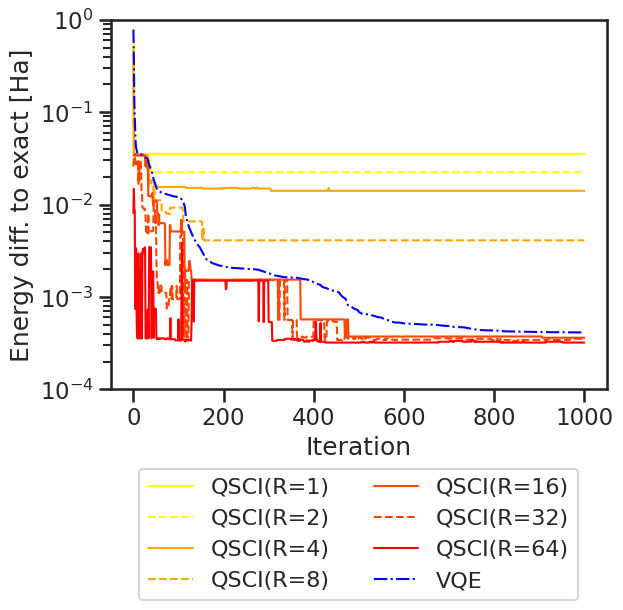

VQE parameters = [ 5.54344246e+00  1.26313938e+00  3.07930704e+00  7.04254103e+00
  5.86694504e+00 -3.06435356e+00  2.99146514e+00 -4.25386668e-01
 -3.53972598e-01  1.30685030e+00  4.49879056e-01  6.24352728e+00
  1.92091508e+00  3.56737053e-01  1.37139444e+00 -1.45702433e+00
  5.51029693e+00 -1.08350857e-01  1.01554111e+00 -2.26811561e+00
 -7.78665086e+00  1.61405799e+00  3.24511402e+00 -2.33146913e+00
  7.84030144e+00 -3.95048351e+00  2.68706736e-01 -1.11583625e+00
  5.88042322e+00  3.56644044e+00 -6.86959017e-01 -3.72090477e-02
 -3.63161712e+00 -6.19954125e+00 -1.53393111e+00  1.20293667e+00
  4.32688981e+00  4.32600951e+00 -1.54987080e+00 -6.81977708e-01
 -2.66323644e+00 -5.20904452e+00 -4.66055656e+00  6.33199661e+00
 -2.94654567e+00 -1.78453336e+00 -3.55747201e+00  4.12553355e+00
 -5.53141167e+00  7.69815219e-02 -3.05120435e+00  1.87870552e+00
 -1.59530201e+00 -3.48883991e+00  8.03244977e-01  1.56722963e+00
  6.64055660e-01  1.27895669e+00 -2.38698049e+00 -1.32028932e+00
 -1.2300

In [16]:
ene_QSCI_Rs_hist = np.array(ene_QSCI_Rs_hist)


plt.plot(ene_QSCI_Rs_hist[:,0] -casci[0], color="yellow",    linestyle="solid",   lw=1.5, label="QSCI(R=1)")
plt.plot(ene_QSCI_Rs_hist[:,1] -casci[0], color="yellow",    linestyle="dashed",  lw=1.5, label="QSCI(R=2)")
plt.plot(ene_QSCI_Rs_hist[:,2] -casci[0], color="orange",    linestyle="solid",   lw=1.5, label="QSCI(R=4)")
plt.plot(ene_QSCI_Rs_hist[:,3] -casci[0], color="orange",    linestyle="dashed",  lw=1.5, label="QSCI(R=8)")
plt.plot(ene_QSCI_Rs_hist[:,4] -casci[0], color="orangered", linestyle="solid",   lw=1.5, label="QSCI(R=16)")
plt.plot(ene_QSCI_Rs_hist[:,5] -casci[0], color="orangered", linestyle="dashed",  lw=1.5, label="QSCI(R=32)")
plt.plot(ene_QSCI_Rs_hist[:,6] -casci[0], color="red",       linestyle="solid",   lw=1.5, label="QSCI(R=64)")
plt.plot(ene_hist -casci[0],              color="blue",      linestyle="dashdot", lw=1.5, label="VQE") 
plt.legend(loc="lower center", bbox_to_anchor=(0.5, -0.6), ncol=2, fontsize=16)
plt.plot()
plt.xlabel("Iteration")
plt.ylabel("Energy diff. to exact [Ha]")
plt.yscale("log", base=10)
plt.ylim(1e-4, 1e0)
plt.show()


print(f"VQE parameters = {opt.x}")
print(f"VQE energy = {ene_hist[-1]}")
print(f"CASCI energy = {casci[0]}")
print(f"VQE-CASCI diff. = {ene_hist[-1] -casci[0]}")